In [1]:
using VegaLite, VegaDatasets

In [2]:
us10m = dataset("us-10m")

Vega JSON Dataset

<h1>Introduction to VegaLite</h1>

In [14]:
p = @vlplot(
    width = 640, 
    height = 360, 
    title = "US Map by county",
    projection = {type="albersUsa"},
    data = {
        values = us10m,
        format = {
            type = :topojson, 
            feature = :counties 
        }
    },
    mark = {
        type = :geoshape,
        fill = :lightgray,
        stroke = :white
    }
)

save("p_us_states.svg", p)

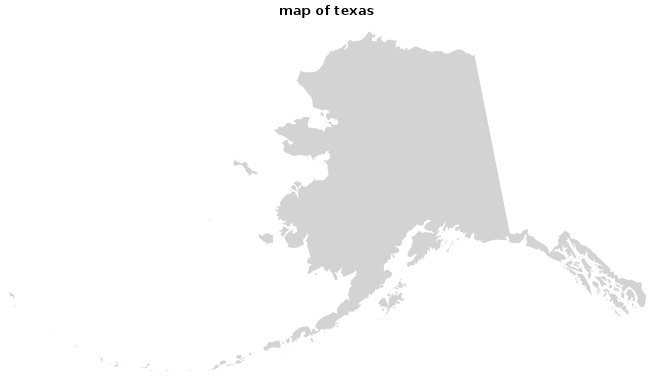

In [7]:
canvas = @vlplot(
    width = 640, 
    height = 360, 
    title = "map of texas",
    projection = {type="albersUsa"},
)

st_map = @vlplot(
    data = {
        values = us10m,
        format = {
            type = :topojson, 
            feature = :states 
        }
    }, 
    transform = [
        {filter = {field = :id, equal = "2"}}
    ],
    mark = {
        type = :geoshape,
        fill = :lightgray,
        stroke = :white
    }
)

p = canvas + st_map 


In [10]:
capitals = dataset("us-state-capitals")

lon,lat,state,city
-86.2791,32.3615,"""Alabama""","""Montgomery"""
-134.42,58.3019,"""Alaska""","""Juneau"""
-112.074,33.4485,"""Arizona""","""Phoenix"""
-92.3311,34.736,"""Arkansas""","""Little Rock"""
-121.469,38.5556,"""California""","""Sacramento"""
-104.984,39.7392,"""Colorado""","""Denver"""
-72.677,41.767,"""Connecticut""","""Hartford"""
-75.5268,39.1619,"""Delaware""","""Dover"""
-84.2728,30.4518,"""Florida""","""Tallahassee"""
-84.39,33.76,"""Georgia""","""Atlanta"""


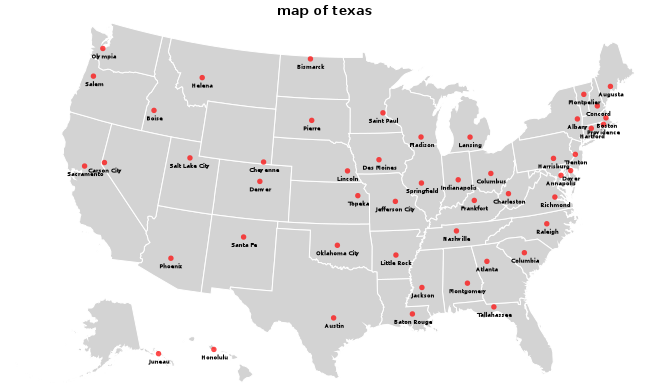

In [13]:
canvas = @vlplot(
    width = 640, 
    height = 360, 
    title = "map of texas",
    projection = {type="albersUsa"},
)

usmap = @vlplot(
    data = {
        values = us10m,
        format = {
            type = :topojson, 
            feature = :states 
        }
    }, 
    mark = {
        type = :geoshape,
        fill = :lightgray,
        stroke = :white
    }
)

capitalmap = @vlplot(
    data = capitals, 
    mark = :circle, 
    latitude = "lat:q",
    longitude = "lon:q",
    color = {value = :red} 
)

capitalnames = @vlplot(
    data = capitals, 
    mark = {
        type = :text,
        dy = 8,
        fontSize = 6 
    }, 
    latitude = "lat:q",
    longitude = "lon:q",
    text = "city:n",
) 


p = canvas + usmap + capitalmap + capitalnames



In [15]:
unemployment = dataset("unemployment") 
vscodedisplay(unemployment) 

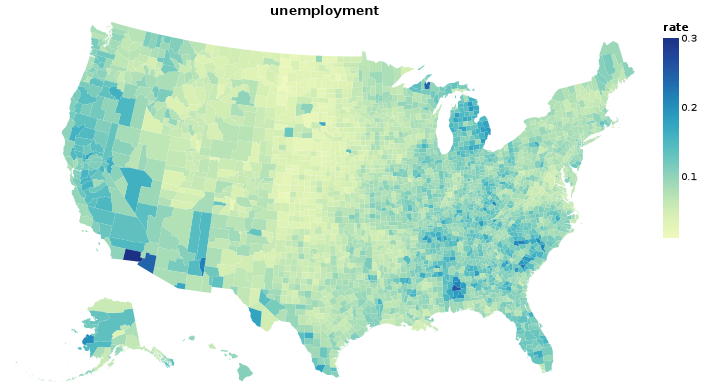

In [17]:
canvas = @vlplot(
    width = 640, 
    height = 360, 
    title = "unemployment",
    projection = {type="albersUsa"},
)

usmap = @vlplot(
    data = {
        values = us10m, 
        format = {
            type = :topojson, 
            feature = :counties 
        }
    }, 
    transform = [
        {
            lookup = :id, 
            from = {
                data = unemployment, 
                key = :id, 
                fields = [:rate]
            }
        }
    ], 
    mark = :geoshape,
    color = "rate:q" 
)

p = canvas + usmap 

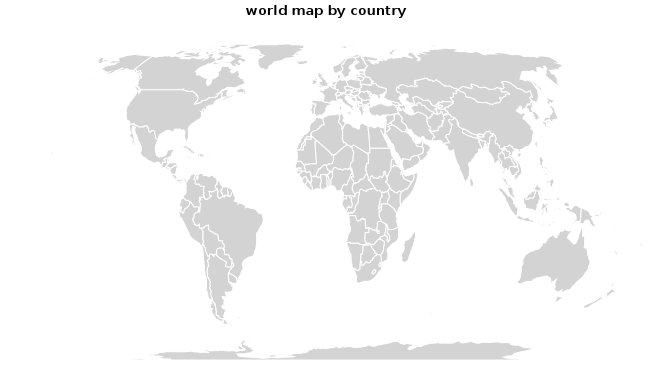

In [19]:
world110m = dataset("world-110m")
canvas = @vlplot(
    width = 640, 
    height = 360, 
    title = "world map by country",
    projection = {type=:equalEarth}
)

worldmap = @vlplot(
    data = {
        values = world110m, 
        format = {
            type = :topojson, 
            feature = :countries 
        }
    }, 
    mark = {type = :geoshape, fill = :lightgray, stroke = :white},
    color = {value = :lightgray} 
)

p = canvas + worldmap

<h1>Map Debt Certificates by State</h1>

In [3]:
using DataFrames, CSV, DataFramesMeta 

In [4]:
# import pre-1790 debt data 
pre1790 = DataFrame(CSV.File("../data/agg_debt_grouped.csv")) 

# clean cents column and sum dollars and cents 
pre1790[:, "amount | 90th"] = getindex.(split.(pre1790[:, "amount | 90th"], "."), 1)
pre1790[:, "amount | 90th"] = replace.(pre1790[:, "amount | 90th"], "/" => "")
pre1790.cents = parse.(Float64, pre1790[:, "amount | 90th"]) ./ 100
pre1790.cents = ifelse.(pre1790.cents .>= 100, 0, pre1790.cents)
pre1790.total_amt = pre1790[:, "amount | dollars"] + pre1790[:, "cents"]
pre1790.dollars = pre1790[:, "amount | dollars"]

# create new dataframe only states and total amount 
select_headers = ["state", "total_amt"]
dropmissing!(pre1790, :state) # remove rows with missing states 
pre1790_states = select(pre1790, select_headers)

# group by state and sum total amount 
pre1790_states = @by(pre1790_states, :state, :total_amt = sum(:total_amt))

# drop cs and f 
pre1790_states = filter(row -> row.state != "cs" && row.state != "f", pre1790_states)
# add numeric code for each state 
pre1790_states.id = [33, 34, 36, 25, 10, 9, 51, 42, 24, 37, 13, 44] 
pre1790_states 


Row,state,total_amt,id
,String3,Float64,Int64
1,nh,1.41627e6,33
2,nj,6.1053e6,34
3,ny,5.37858e6,36
4,ma,1.06787e7,25
5,de,7.29096e5,10
6,ct,6.24912e6,9
7,va,3.38283e6,51
8,pa,3.26083e7,42
9,md,4.62461e6,24


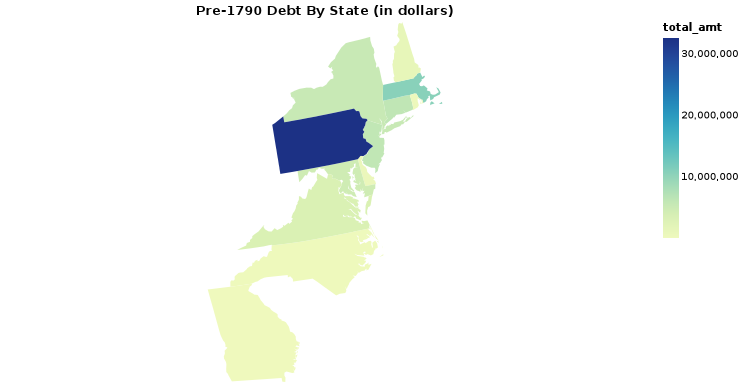

In [12]:
canvas_d = @vlplot(
    width = 640, 
    height = 360, 
    title = "Pre-1790 Debt By State (in dollars)",
    projection = {type="albersUsa"} 
)

usmap_d = @vlplot(
    data = {
        values = us10m, 
        format = {
            type = :topojson, 
            feature = :states 
        }
    }, 
    transform = [
        {
            lookup = :id, 
            from = {
                data = pre1790_states, 
                key = :id, 
                fields = [:total_amt]
            }
        }
    ], 
    mark = :geoshape,
    color = "total_amt:q" 
)

p_d = canvas_d + usmap_d  

In [13]:
# save
save("p_pre1790_dollars.svg", p_d)

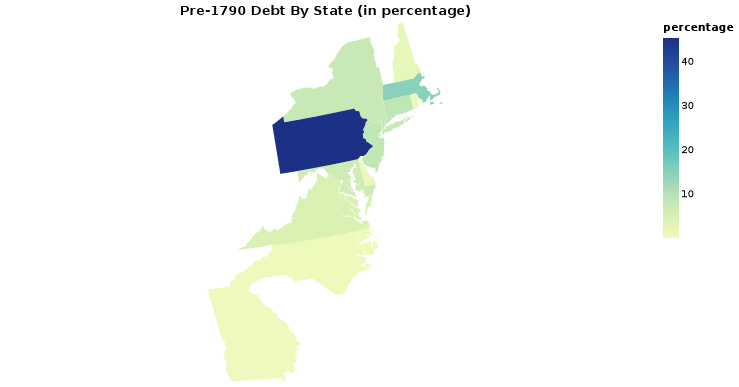

In [14]:
# map of states by percentage 
pre1790_states.percentage = pre1790_states.total_amt ./ sum(pre1790_states.total_amt) * 100

canvas_p = @vlplot(
    width = 640, 
    height = 360, 
    title = "Pre-1790 Debt By State (in percentage)",
    projection = {type="albersUsa"} 
)

usmap_p = @vlplot(
    data = {
        values = us10m, 
        format = {
            type = :topojson, 
            feature = :states 
        }
    }, 
    transform = [
        {
            lookup = :id, 
            from = {
                data = pre1790_states, 
                key = :id, 
                fields = [:percentage]
            }
        }
    ], 
    mark = :geoshape,
    color = "percentage:q" 
)

p_p = canvas_p + usmap_p

In [15]:
# save 
save("p_pre1790_per.svg", p_p)

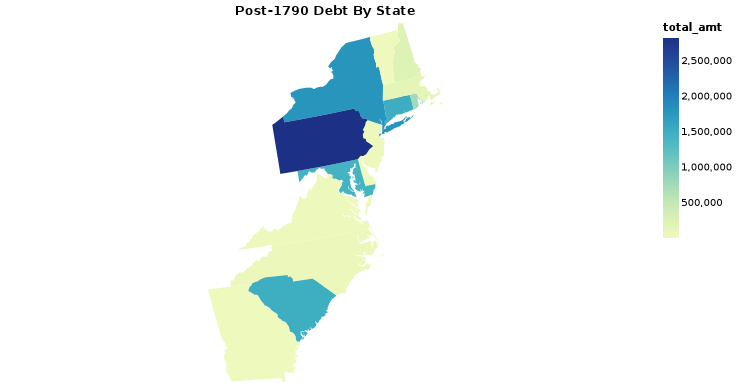

In [18]:
# compare to post-1790 debt data 
post1790 = DataFrame(CSV.File("../../../data_clean/final_data_CD.csv"))

# group by state and sum 
post1790_states = @by(post1790, "Group State", :total_amt = sum(:final_total_adj))
dropmissing!(post1790_states, "Group State") # remove rows with missing states

# add numeric code for each state
post1790_states.id = [36, 44, 9, 33, 34, 24, 45, 42, 13, 25, 37, 10, 51, 50]

# graph 
canvas = @vlplot(
    width = 640, 
    height = 360, 
    title = "Post-1790 Debt By State",
    projection = {type="albersUsa"} 
)

usmap = @vlplot(
    data = {
        values = us10m, 
        format = {
            type = :topojson, 
            feature = :states 
        }
    }, 
    transform = [
        {
            lookup = :id, 
            from = {
                data = post1790_states, 
                key = :id, 
                fields = [:total_amt]
            },
        }
    ], 
    mark = :geoshape,
    color = "total_amt:q"
)

p_post = canvas + usmap 


In [16]:
save("p_post1790.svg", p_post)

In [24]:
minimum(post1790_states.total_amt)

5908.47

In [9]:
# save 
save("results/pierce/p_pre1790.png", p)

<h1>Pierce Certs Origins</h1>

In [10]:
using XLSX 

In [11]:
pierce_certs_org = DataFrame(XLSX.readtable("../../../data_raw/pre1790/Pierce_Certs_cleaned_2019.xlsx", "Pierce_Certs_cleaned_2019"))
# keep state and value columns 
pierce_certs = select(pierce_certs_org, ["State", "Value"])
# drop missing states
dropmissing!(pierce_certs, :State)
# replace missing values with 0 
pierce_certs.Value = coalesce.(pierce_certs.Value, 0)
# remove cs and f 
pierce_certs = filter(row -> row.State != "CS" && row.State != "F", pierce_certs)

# group by state and sum value 
pierce_certs_gdf = @by(pierce_certs, :State, :Value = sum(:Value))
sort!(pierce_certs_gdf, :Value, rev = true) # sort by value descending

# add numeric code for each state
pierce_certs_gdf.id = [25, 42, 9, 36, 51, 24, 34, 33, 37, 10, 13, 44]
pierce_certs_gdf

Row,State,Value,id
,Any,Float64,Int64
1,MA,2.2176e6,25
2,PA,1.1475e6,42
3,CT,1.13799e6,9
4,NY,7.74935e5,36
5,VA,6.53915e5,51
6,MD,5.50015e5,24
7,NJ,5.13349e5,34
8,NH,3.80286e5,33
9,NC,3.29383e5,37


In [18]:
canvas = @vlplot(
    width = 640, 
    height = 360, 
    title = "Pierce Certificates by State",
    projection = {type="albersUsa"} 
)

usmap = @vlplot(
    data = {
        values = us10m, 
        format = {
            type = :topojson, 
            feature = :states 
        }
    }, 
    transform = [
        {
            lookup = :id, 
            from = {
                data = pierce_certs_gdf, 
                key = :id, 
                fields = [:Value]
            }
        }
    ], 
    mark = :geoshape,
    color = "Value:q" 
)

p = canvas + usmap 

UndefVarError: UndefVarError: `pierce_certs_gdf` not defined

In [13]:
save("results/pierce/p_pierce_certs.png", p)

<h1>By Regiment</h1>

In [27]:
pierce_certs_org.Value = coalesce.(pierce_certs_org.Value, 0)
pierce_certs_reg = @by(pierce_certs_org, "To Whom Issued", :Value = sum(:Value), :Group = first(:Group))

Row,To Whom Issued,Value,Group
,Any,Float64,Int64
1,Second New York Artillery under Col. John Lamb; W. Stevens agent,2.32103e5,80
2,Regiment supposed to be Connecticut paid to November 4 1783,54740.6,58
3,Regiment paid to January 1 1781,9130.11,62
4,Regiment paid to January 1 1783,59298.2,68
5,First Regiment and old Third of New Jersey under Col. Albert Ogden paid to November 4 1783; John Blair agent,2.48721e5,38
6,Officers etc. Virginia paid to November 15 1783,6.53915e5,98
7,Fourth Pennsylvania Dragoons Col. Stephen Moylan; Bowen & Betty agents,91169.6,94
8,First Regiment of Col. R. J. Meigs Connecticut paid to November 4 1783; Charles Fanning agent,1.16074e5,16
9,Dragoons Col. E. Sheldon Connecticut paid to January 1 1784; Elijah Jones paymaster,1.38505e5,51


In [28]:
pierce_certs_reg.regiment = pierce_certs_reg[:, "To Whom Issued"]
pierce_certs_reg = @by(pierce_certs_reg, "Group", :Value = sum(:Value), :regiment = first(:regiment))

# remove semi-colon 
pierce_certs_reg.regiment = replace.(pierce_certs_reg.regiment, ";" => ":")

# create new column of percent owned 
pierce_certs_reg.percent_owned = (pierce_certs_reg.Value ./ sum(pierce_certs_reg.Value)) * 100

sort!(pierce_certs_reg, :Value, rev = true) # sort by value descending

Row,Group,Value,regiment,percent_owned
,Int64,Float64,String,Float64
1,98,6.53915e5,Officers etc. Virginia paid to November 15 1783,6.03637
2,118,4.358e5,Officers and men,4.02293
3,83,3.71038e5,Officers paid to different periods,3.42509
4,121,3.02626e5,Regiment under Col. Thomas Clarke North Carolina paid to November 15 1783: R. Fenner agent,2.79358
5,67,2.92385e5,Second Artillery under Col. John Crane Massachusetts paid to November 4 1783: C. Knowles agent,2.69904
6,123,2.84041e5,Officers etc. paid to different periods,2.62202
7,38,2.48721e5,First Regiment and old Third of New Jersey under Col. Albert Ogden paid to November 4 1783: John Blair agent,2.29597
8,1,2.46649e5,Officers of Connecticut paid to May 22 1783,2.27684
9,42,2.37486e5,First Regiment Massachusetts Col. J. Vose: Eggleston paymaster agent,2.19226


In [29]:
# save 
CSV.write("results/pierce/pierce_certs_reg.csv", pierce_certs_reg)

"results/pierce/pierce_certs_reg.csv"

In [ ]:
# graph percent owned by regiment 